In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns;sns.set()
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
from matplotlib import cm
from pandas import read_csv, set_option
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer,RobustScaler
from sklearn.model_selection import train_test_split, KFold, cross_val_score, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from catboost import CatBoostClassifier,CatBoostRegressor
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor
from sklearn.feature_selection import SelectKBest,f_regression
from xgboost import plot_importance,XGBClassifier,XGBRegressor
from sklearn.model_selection import learning_curve
from sklearn.pipeline import Pipeline
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier, RandomForestClassifier, ExtraTreesClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn import preprocessing
import shap

# from sklearn.decomposition import PCA
# from sklearn.decomposition import SparsePCA
# from sklearn.decomposition import KernelPCA
# from sklearn.decomposition import IncrementalPCA
# from sklearn.decomposition import TruncatedSVD
# from sklearn.decomposition import MiniBatchDictionaryLearning
# from sklearn.decomposition import FastICA
# from sklearn.manifold import Isomap
# from sklearn.manifold import MDS
# from sklearn.manifold import LocallyLinearEmbedding
# from sklearn.manifold import TSNE
# from sklearn.random_projection import GaussianRandomProjection
# from sklearn.random_projection import SparseRandomProjection

import time
import warnings
warnings.filterwarnings('ignore')
sns.set(style='whitegrid')
%matplotlib inline

In [61]:
df=pd.read_csv("historyy.csv")

In [62]:
df

,unix,date,symbol,open,high,low,close,Volume BTC,Volume USD
0,1646106180,2022-03-01 03:43:00,BTC/USD,43046.58,43046.58,43046.58,43046.58,0.000000,0.000000
1,1646106060,2022-03-01 03:41:00,BTC/USD,43018.23,43046.59,43018.23,43046.58,0.142977,6154.673021
2,1646106000,2022-03-01 03:40:00,BTC/USD,43022.24,43022.24,43016.03,43016.03,0.009230,397.037957
3,1646105940,2022-03-01 03:39:00,BTC/USD,43035.16,43035.16,42999.44,42999.44,0.820950,35300.390268
4,1646105880,2022-03-01 03:38:00,BTC/USD,43077.82,43077.82,43049.46,43049.46,0.022210,956.143143
...,...,...,...,...,...,...,...,...,...
610777,1609459500,2021-01-01 00:05:00,BTC/USD,29021.86,29023.38,28982.33,28999.50,1.062360,30807.899250
610778,1609459440,2021-01-01 00:04:00,BTC/USD,29048.13,29057.73,29035.61,29045.19,1.446538,42014.959434
610779,1609459380,2021-01-01 00:03:00,BTC/USD,29037.68,29069.39,29019.00,29048.13,2.189621,63604.382387
610780,1609459320,2021-01-01 00:02:00,BTC/USD,29069.80,29073.02,29028.14,29035.89,3.030301,87987.499279


In [63]:
import datetime, pytz
#define a conversion function for the native timestamps in the csv file
def dateparse (time_in_secs):    
    return pytz.utc.localize(datetime.datetime.fromtimestamp(float(time_in_secs)))

# Data Periods used in Notebook
plot_period = slice('2021-7-7 0:00','2021-7-7 8:00') # Selectio Plot Period for visualisation only
data_period = slice('2021-7-6 13:21','2021-9-14 0:00') # Select Data Period for Analysis

In [64]:
df['unix'] = df['unix'].apply(dateparse)
df.set_index('unix', inplace=True)
df

,date,symbol,open,high,low,close,Volume BTC,Volume USD
unix,,,,,,,,
2022-03-01 06:43:00+00:00,2022-03-01 03:43:00,BTC/USD,43046.58,43046.58,43046.58,43046.58,0.000000,0.000000
2022-03-01 06:41:00+00:00,2022-03-01 03:41:00,BTC/USD,43018.23,43046.59,43018.23,43046.58,0.142977,6154.673021
2022-03-01 06:40:00+00:00,2022-03-01 03:40:00,BTC/USD,43022.24,43022.24,43016.03,43016.03,0.009230,397.037957
2022-03-01 06:39:00+00:00,2022-03-01 03:39:00,BTC/USD,43035.16,43035.16,42999.44,42999.44,0.820950,35300.390268
2022-03-01 06:38:00+00:00,2022-03-01 03:38:00,BTC/USD,43077.82,43077.82,43049.46,43049.46,0.022210,956.143143
...,...,...,...,...,...,...,...,...
2021-01-01 03:05:00+00:00,2021-01-01 00:05:00,BTC/USD,29021.86,29023.38,28982.33,28999.50,1.062360,30807.899250
2021-01-01 03:04:00+00:00,2021-01-01 00:04:00,BTC/USD,29048.13,29057.73,29035.61,29045.19,1.446538,42014.959434
2021-01-01 03:03:00+00:00,2021-01-01 00:03:00,BTC/USD,29037.68,29069.39,29019.00,29048.13,2.189621,63604.382387


In [65]:
# It's possible to reduce the dataframe memory by 62% (if you need)
# red_df = red_mem(df)
def red_mem(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))

    return df

In [66]:
df = df.sort_index()
df=df.loc[data_period]
df

,date,symbol,open,high,low,close,Volume BTC,Volume USD
unix,,,,,,,,
2021-07-06 13:21:00+00:00,2021-07-06 10:21:00,BTC/USD,34000.16,34009.44,33996.40,34009.44,0.162125,5513.774338
2021-07-06 13:22:00+00:00,2021-07-06 10:22:00,BTC/USD,34009.61,34009.61,33989.80,33989.80,0.024200,822.553160
2021-07-06 13:23:00+00:00,2021-07-06 10:23:00,BTC/USD,33986.84,33992.50,33986.84,33992.50,0.214740,7299.558968
2021-07-06 13:24:00+00:00,2021-07-06 10:24:00,BTC/USD,33982.22,33982.22,33969.72,33973.48,2.035375,69148.759285
2021-07-06 13:25:00+00:00,2021-07-06 10:25:00,BTC/USD,33976.36,33997.54,33976.36,33989.80,0.025459,865.357195
...,...,...,...,...,...,...,...,...
2021-09-13 23:56:00+00:00,2021-09-13 20:56:00,BTC/USD,45027.13,45027.13,44996.58,44998.53,0.094744,4263.362776
2021-09-13 23:57:00+00:00,2021-09-13 20:57:00,BTC/USD,45024.43,45037.69,45024.43,45028.33,0.031690,1426.947778
2021-09-13 23:58:00+00:00,2021-09-13 20:58:00,BTC/USD,45042.34,45170.16,45031.20,45167.28,6.786128,306510.921812


In [67]:
train_df, test_df = train_test_split(df, test_size=0.2, shuffle=False)

In [68]:
train_df

,date,symbol,open,high,low,close,Volume BTC,Volume USD
unix,,,,,,,,
2021-07-06 13:21:00+00:00,2021-07-06 10:21:00,BTC/USD,34000.16,34009.44,33996.40,34009.44,0.162125,5513.774338
2021-07-06 13:22:00+00:00,2021-07-06 10:22:00,BTC/USD,34009.61,34009.61,33989.80,33989.80,0.024200,822.553160
2021-07-06 13:23:00+00:00,2021-07-06 10:23:00,BTC/USD,33986.84,33992.50,33986.84,33992.50,0.214740,7299.558968
2021-07-06 13:24:00+00:00,2021-07-06 10:24:00,BTC/USD,33982.22,33982.22,33969.72,33973.48,2.035375,69148.759285
2021-07-06 13:25:00+00:00,2021-07-06 10:25:00,BTC/USD,33976.36,33997.54,33976.36,33989.80,0.025459,865.357195
...,...,...,...,...,...,...,...,...
2021-08-31 02:36:00+00:00,2021-08-30 23:36:00,BTC/USD,47160.65,47196.27,47134.00,47140.96,0.246236,11607.811798
2021-08-31 02:37:00+00:00,2021-08-30 23:37:00,BTC/USD,47135.70,47141.85,47100.00,47135.02,1.932630,91094.550874
2021-08-31 02:38:00+00:00,2021-08-30 23:38:00,BTC/USD,47120.00,47389.40,47085.00,47268.57,18.450655,872136.075050


In [69]:
test_df

,date,symbol,open,high,low,close,Volume BTC,Volume USD
unix,,,,,,,,
2021-08-31 02:41:00+00:00,2021-08-30 23:41:00,BTC/USD,47190.34,47203.96,47048.20,47117.24,3.248413,153056.267191
2021-08-31 02:42:00+00:00,2021-08-30 23:42:00,BTC/USD,47093.91,47127.01,47072.81,47080.53,0.095050,4475.013793
2021-08-31 02:43:00+00:00,2021-08-30 23:43:00,BTC/USD,47046.20,47092.35,47033.08,47056.72,10.579490,497836.117966
2021-08-31 02:44:00+00:00,2021-08-30 23:44:00,BTC/USD,47066.39,47066.39,47030.00,47030.00,3.625139,170490.308804
2021-08-31 02:45:00+00:00,2021-08-30 23:45:00,BTC/USD,47030.00,47070.43,47008.00,47008.00,6.682632,314137.150954
...,...,...,...,...,...,...,...,...
2021-09-13 23:56:00+00:00,2021-09-13 20:56:00,BTC/USD,45027.13,45027.13,44996.58,44998.53,0.094744,4263.362776
2021-09-13 23:57:00+00:00,2021-09-13 20:57:00,BTC/USD,45024.43,45037.69,45024.43,45028.33,0.031690,1426.947778
2021-09-13 23:58:00+00:00,2021-09-13 20:58:00,BTC/USD,45042.34,45170.16,45031.20,45167.28,6.786128,306510.921812


In [70]:
NaN_values = (train_df.isnull().sum()/len(train_df)*100).sort_values(ascending = False)
NaN_values

date          0.0
symbol        0.0
open          0.0
high          0.0
low           0.0
close         0.0
Volume BTC    0.0
Volume USD    0.0
dtype: float64

In [71]:
def bar_plot(x, y,palette_len,title='Missing Values (%)', xlim = None, ylim = None, 
             xticklabels = None, yticklabels = None,xlabel = None, ylabel = None, 
             figsize = (10,4),axis_grid = 'y'):
        
    cmap = sns.color_palette("plasma")
    fig, ax = plt.subplots(figsize = figsize)
    plt.title(title,size = 15, fontweight = 'bold')

    for i in ['top', 'right', 'bottom', 'left']:
        ax.spines[i].set_color('black')
    
    ax.spines['top'].set_visible(True);ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False);ax.spines['left'].set_visible(False)

    sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
                palette = cmap)
    ax.set_xlim(xlim);ax.set_ylim(ylim)    
    ax.set_xticklabels(xticklabels);ax.set_yticklabels(yticklabels)
    plt.xlabel(xlabel);plt.ylabel(ylabel)
    ax.grid(axis = axis_grid,ls='--',alpha = 0.9)
    plt.show()

In [91]:
# # Plot missing data
# bar_plot(x = NaN_values,y = NaN_values.index,palette_len = NaN_values.index, 
#          xlim = (0,100),xticklabels = range(0,101,20),yticklabels = NaN_values.index,
#          figsize = (8,5))

In [73]:
train_df[train_df.isna().any(axis=1)]

,date,symbol,open,high,low,close,Volume BTC,Volume USD
unix,,,,,,,,


In [74]:
def forward_fill_na(ldf):
    ldf['open'].fillna(method='ffill', inplace=True)
    ldf['high'].fillna(method='ffill', inplace=True)
    ldf['low'].fillna(method='ffill', inplace=True)
    ldf['close'].fillna(method='ffill', inplace=True)
    
forward_fill_na(train_df)
forward_fill_na(test_df)

In [75]:
train_df = train_df.dropna()
test_df = test_df.dropna()

In [76]:
train_df.describe()

,open,high,low,close,Volume BTC,Volume USD
count,80000.000000,80000.000000,80000.000000,80000.000000,80000.000000,8.000000e+04
mean,40327.448618,40345.940596,40307.951716,40327.775429,1.839713,7.375286e+04
std,6482.958754,6485.571886,6480.209678,6483.017475,4.378735,1.766718e+05
min,29301.000000,29409.000000,29296.390000,29317.730000,0.000000,0.000000e+00
25%,33595.915000,33607.465000,33583.972500,33597.090000,0.136805,5.456114e+03
50%,40124.475000,40149.995000,40100.710000,40126.400000,0.578928,2.257865e+04
75%,46455.750000,46476.235000,46433.595000,46457.147500,1.890140,7.420342e+04
max,50497.950000,50562.110000,50491.370000,50507.340000,222.397677,8.762466e+06


In [77]:
#(1) Рынок поднимется (откроем длинную позицию),
#(2) Рынок упадет (откройте короткую позицию)
#(3) Рынок будет двигаться вбок (не открывать позиций).
# прогнозирования сигнала покупки (значение = 1) или продажи (значение = 0) 
# классификация - 0 и 1
# покупка - бычий, продажа - медвежий

In [78]:
#Если краткосрочная скользящая средняя (SMA1) больше долгосрочной скользящей средней (SMA2), 
#это считается сигналом на покупку (значение сигнала = 1). Иначе 0 - продажа
#. Когда краткосрочная SMA пересекает долгосрочную SMA снизу вверх, это сигнал на покупку,
# а когда сверху вниз, это сигнал на продажу.

In [79]:
#Сигнал на покупку (бычий сигнал): Когда краткосрочная скользящая средняя (SMA1) пересекает 
#   долгосрочную скользящую среднюю (SMA2) снизу вверх, это указывает на то, что недавние цены 
#   растут быстрее, чем исторические цены. Это может свидетельствовать о начале восходящего тренда.
#Сигнал на продажу (медвежий сигнал): Когда краткосрочная скользящая средняя пересекает 
#   долгосрочную скользящую среднюю сверху вниз, это указывает на то, что недавние цены падают
#   быстрее, чем исторические цены. Это может свидетельствовать о начале нисходящего тренда.

In [80]:
def create_target(ldf,tr_id=False):
    ldf['SMA1'] = ldf['close'].rolling(window=10, min_periods=1, center=False).mean() #  short
    ldf['SMA2'] = ldf['close'].rolling(window=60, min_periods=1, center=False).mean() #  long
    ldf['signal'] = np.where(ldf['SMA1'] > ldf['SMA2'], 1.0, 0.0) # Create signals
    
train_df1 = train_df.copy() 
test_df1 = test_df.copy()
create_target(train_df1)
create_target(test_df1)  # Add target variable to Test Set
train_df1['signal'].value_counts()

signal
1.0    42000
0.0    38000
Name: count, dtype: int64

In [81]:
train_df2=train_df1.tail(1000)

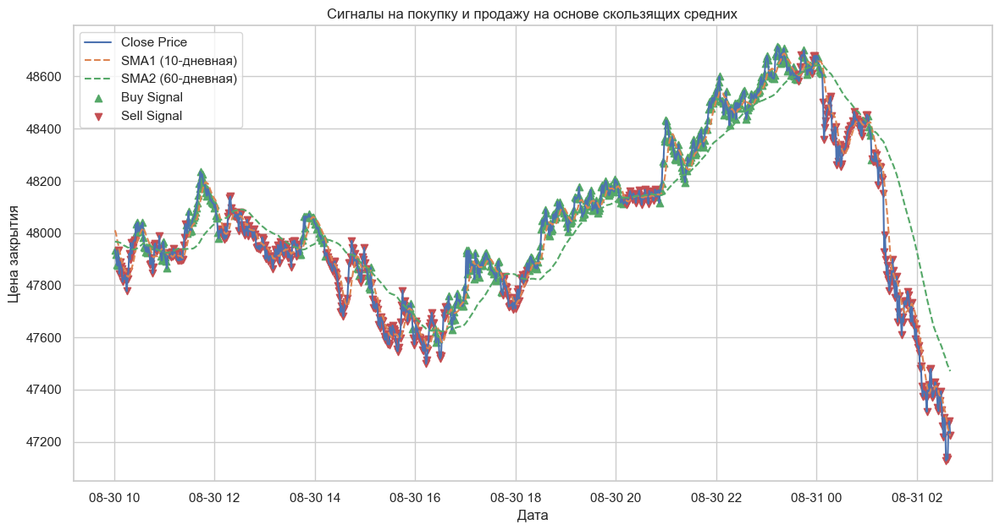

In [82]:
import matplotlib.pyplot as plt

plt.figure(figsize=(14,7))
plt.plot(train_df2['close'], label='Close Price')
plt.plot(train_df2['SMA1'], label='SMA1 (10-дневная)', linestyle='--')
plt.plot(train_df2['SMA2'], label='SMA2 (60-дневная)', linestyle='--')

# Отображение сигналов
buy_signals = train_df2[train_df2['signal'] == 1.0]
sell_signals = train_df2[train_df2['signal'] == 0.0]

plt.scatter(buy_signals.index, buy_signals['close'], marker='^', color='g', label='Buy Signal', alpha=1)
plt.scatter(sell_signals.index, sell_signals['close'], marker='v', color='r', label='Sell Signal', alpha=1)

plt.legend(loc='best')
plt.title('Сигналы на покупку и продажу на основе скользящих средних')
plt.xlabel('Дата')
plt.ylabel('Цена закрытия')
plt.grid(True)
plt.show()

In [92]:
# # Создание подграфиков с общей осью X
# features = ['close', 'signal']
# fig = make_subplots(rows=len(features), shared_xaxes=True)

# # Добавление линий для каждого признака с разной толщиной
# for i, feature in enumerate(features, start=1):
#     line_width = 2 if i == 1 else 0.4  # Установка разной толщины для разных графиков
#     fig.add_trace(go.Scatter(x=train_df1.index, y=train_df1[feature], mode='lines', name=feature, line=dict(width=line_width)), row=i, col=1)

# # Обновление макета графика
# fig.update_layout(template='plotly_white', margin=dict(l=50, r=80, t=50, b=40),title='Weighted Price & Signal Fluctional in Training Data')
# fig.show()


In [84]:
def plot_line(ldf,lst,title='',sec_id=None,size=[350,1000]):
    
    # sec_id - list of [False,False,True] values of when to activate supblots; same length as lst
    
    if(sec_id is not None):
        fig = make_subplots(specs=[[{"secondary_y": True}]])
    else:
        fig = go.Figure()
        
    if(len(lst) is not 1):
        ii=-1
        for i in lst:
            ii+=1
            if(sec_id is not None):
                fig.add_trace(go.Scatter(x=ldf.index, y=ldf[lst[ii]],mode='lines',name=lst[ii],line=dict(width=2.0)),secondary_y=sec_id[ii])
            else:
                fig.add_trace(go.Scatter(x=ldf.index, y=ldf[lst[ii]],mode='lines',name=lst[ii],line=dict(width=2.0)))
    else:
        fig.add_trace(go.Scatter(x=ldf.index, y=ldf[lst[0]],mode='lines',name=lst[0],line=dict(width=2.0)))

    fig.update_layout(height=size[0],width=size[1],template='plotly_white',title=title,
                          margin=dict(l=50,r=80,t=50,b=40));fig.show()

In [85]:
# Visualise Training Set Target Variable Related Features

columns = ['SMA1','SMA2','signal']
ldf = train_df1.loc[plot_period,columns]
plot_line(ldf,columns,
          title='SM1, SMA2 & Signal created from Closing Price',
          sec_id=[False,False,True])  

In [86]:
train_df1=train_df1.drop(['SMA1','SMA2','date','symbol'], axis=1)
test_df1=test_df1.drop(['SMA1','SMA2','date','symbol'], axis=1)

In [87]:
train_df1_corr=train_df1.corr()
train_df1_corr['signal']

open          0.026814
high          0.026867
low           0.027049
close         0.026936
Volume BTC    0.004586
Volume USD    0.006445
signal        1.000000
Name: signal, dtype: float64

In [88]:
train_df2 = train_df1.copy()  # Create duplicate dataframe & add features to it
test_df2 = test_df1.copy()
test_df2

,open,high,low,close,Volume BTC,Volume USD,signal
unix,,,,,,,
2021-08-31 02:41:00+00:00,47190.34,47203.96,47048.20,47117.24,3.248413,153056.267191,0.0
2021-08-31 02:42:00+00:00,47093.91,47127.01,47072.81,47080.53,0.095050,4475.013793,0.0
2021-08-31 02:43:00+00:00,47046.20,47092.35,47033.08,47056.72,10.579490,497836.117966,0.0
2021-08-31 02:44:00+00:00,47066.39,47066.39,47030.00,47030.00,3.625139,170490.308804,0.0
2021-08-31 02:45:00+00:00,47030.00,47070.43,47008.00,47008.00,6.682632,314137.150954,0.0
...,...,...,...,...,...,...,...
2021-09-13 23:56:00+00:00,45027.13,45027.13,44996.58,44998.53,0.094744,4263.362776,1.0
2021-09-13 23:57:00+00:00,45024.43,45037.69,45024.43,45028.33,0.031690,1426.947778,1.0
2021-09-13 23:58:00+00:00,45042.34,45170.16,45031.20,45167.28,6.786128,306510.921812,1.0


In [89]:
# %1)K (быстрый стохастический осциллятор
# %K представляет собой текущую позицию закрытия актива в пределах 
# диапазона его цен за определенный период времени
    
# %D (медленный стохастический осциллятор)
# %D представляет собой скользящее среднее по значениям %K.

# 2)Индекс относительной силы (RSI) - это технический индикатор, 
# используемый для оценки степени, в которой актив считается 
# перекупленным или перепроданным на рынке. 

# 3) Перекупленный - значит много купили, скоро упадет

# перепроданный - много продали, скоро возрастет

In [90]:
# ROC выражается в процентах и показывает относительное изменение цены актива за определенный период времени. Более высокие значения ROC указывают на
# более быстрое изменение цены вверх, тогда как более низкие значения ROC указывают на более медленное изменение или даже снижение цены актива.

# Активы с высокими значениями ROC могут считаться более перекупленными, поскольку их цена быстро возрастает и может стать завышенной, в то время как 
# активы с низкими значениями ROC могут считаться более перепроданными, поскольку их цена снижается или изменяется медленнее.

In [32]:
# Принимая значения в диапазоне от 0 до 100, RSI позволяет определить степень, в которой цены актива изменялись вверх или вниз за определенный период времени.
# Более высокие значения RSI указывают на более сильный восходящий тренд, в то время как более низкие значения RSI указывают на сильный нисходящий тренд.

# Основные уровни RSI, которые часто используются в анализе, - это 70 и 30. Значение RSI выше 70 часто интерпретируется как сигнал о том, что актив перекуплен,
# то есть цена актива, вероятно, слишком высока и может скоро начать снижаться. С другой стороны, значение RSI ниже 30 может указывать на то, что актив недопродан 
# и недооценен,
# что может быть сигналом для возможного повышения цены.

In [33]:
#Импульс (MOM): это скорость ускорения цены или объема ценной бумаги; скорость изменения цены.

In [34]:
#Включить признаки с высокой линейной корреляцией с целевой переменной: Это помогает захватить основное 
#направление зависимости.
#Включить признаки с возможными нелинейными зависимостями: Это помогает модели захватывать сложные паттерны.
#Включить признаки, которые не сильно коррелируют между собой: Это помогает избежать дублирования 
#информации и улучшает обобщающую способность модели.

In [35]:
''' Technical Indicators '''

#Calculation of moving average
def ma(df, n):
    return pd.Series(df['close'].rolling(n, min_periods=n).mean(), name='MA_' + str(n))

# exponentially weighted moving average 
def ema(df, n):
    return pd.Series(df['close'].ewm(span=n,min_periods=n).mean(), name='EMA_' + str(n))

#Calculation of price momentum
def mom(df, n):     
    return pd.Series(df.diff(n), name='Momentum_' + str(n))  

# rate of change
def roc(df, n):  # Показывает на сколько процентов цена увеличилась/уменьшилась
    M = df.diff(n - 1) ; N = df.shift(n - 1)  
    return pd.Series(((M / N) * 100), name = 'ROC_' + str(n)) 

# relative strength index
def rsi(df, period): # значение перекупленности или перепроданности от 0 до 100
    delta = df.diff().dropna()
    u = delta * 0; d = u.copy()
    u[delta > 0] = delta[delta > 0]; d[delta < 0] = -delta[delta < 0]
    u[u.index[period-1]] = np.mean( u[:period] ) #first value is sum of avg gains
    u = u.drop(u.index[:(period-1)])
    d[d.index[period-1]] = np.mean( d[:period] ) #first value is sum of avg losses
    d = d.drop(d.index[:(period-1)])
    rs = u.ewm(com=period-1, adjust=False).mean() / d.ewm(com=period-1, adjust=False).mean()
    return 100 - 100 / (1 + rs)

# stochastic oscillators slow & fast
def sto(close, low, high, n,id): 
    stok = ((close - low.rolling(n).min()) / (high.rolling(n).max() - low.rolling(n).min())) * 100
    if(id is 0):
        return stok
    else:
        return stok.rolling(3).mean()
# %K близко к 0 указывает на то, что текущая цена ближе к минимальной цене за период, 
# что может сигнализировать о перепроданности рынка.
# %K близко к 100 указывает на то, что текущая цена ближе к максимальной цене за период,
# что может сигнализировать о перекупленности рынка.

In [36]:
def tech_indi(ldf,tr_id=True):

    ''' Moving Average '''
    ldf['MA21'] = ma(ldf,10)
    ldf['MA63'] = ma(ldf, 30)
    ldf['MA252'] = ma(ldf, 200)
    lst_MA = ['MA21','MA63','MA252']

    ''' Exponentially Weighted Moving Average '''
    ldf['EMA10'] = ema(ldf, 10)
    ldf['EMA30'] = ema(ldf, 30)
    ldf['EMA200'] = ema(ldf, 200)
    lst_EMA = ['EMA10','EMA30','EMA200']

    ''' Momentum '''
    ldf['MOM10'] = mom(ldf['close'], 10)
    ldf['MOM30'] = mom(ldf['close'], 30)
    lst_MOM = ['MOM10','MOM30']

    ''' Relative Strength Index '''
    ldf['RSI10'] = rsi(ldf['close'], 10)
    ldf['RSI30'] = rsi(ldf['close'], 30)
    ldf['RSI200'] = rsi(ldf['close'], 200)
    lst_RSI = ['RSI10','RSI30','RSI200']

    ''' Slow Stochastic Oscillators '''
    ldf['%K10'] = sto(ldf['close'], ldf['low'], ldf['high'],5,0)
    ldf['%K30'] = sto(ldf['close'], ldf['low'], ldf['high'],10,0)
    ldf['%K200'] = sto(ldf['close'], ldf['low'], ldf['high'], 20,0)
    lst_pK = ['%K10','%K30','%K200']

    ''' Fast Stochastic Oscillators '''
    ldf['%D10'] = sto(ldf['close'], ldf['low'], ldf['high'], 10,1)
    ldf['%D30'] = sto(ldf['close'], ldf['low'], ldf['high'], 30,1)
    ldf['%D200'] = sto(ldf['close'], ldf['low'], ldf['high'], 200,1)
    lst_pD = ['%D10','%D30','%D200']
    
    # Plot Training Data
    if(tr_id):
        plot_line(ldf.loc[plot_period,lst_MA],lst_MA,title='Moving Average (window=21,63,252)')
        plot_line(ldf.loc[plot_period,lst_EMA],lst_EMA,title='Exponential Moving Average (window=10,30,200)')
        plot_line(ldf.loc[plot_period,lst_MOM],lst_MOM,title='Momentum')
        plot_line(ldf.loc[plot_period,lst_RSI],lst_RSI,title='Relative Strength Index')
        plot_line(ldf.loc[plot_period,lst_pK],lst_pK,title='Stochastic Oscillators (slow)')
        plot_line(ldf.loc[plot_period,lst_pD],lst_pD,title='Stochastic Oscillators (Fast)')

In [37]:
tech_indi(train_df2)
tech_indi(test_df2,tr_id=False)

In [38]:
train_df2.columns

Index(['open', 'high', 'low', 'close', 'Volume BTC', 'Volume USD', 'signal',
       'MA21', 'MA63', 'MA252', 'EMA10', 'EMA30', 'EMA200', 'MOM10', 'MOM30',
       'RSI10', 'RSI30', 'RSI200', '%K10', '%K30', '%K200', '%D10', '%D30',
       '%D200'],
      dtype='object')

In [39]:
train_df2_corr=train_df2.corr()
train_df2_corr['signal'].sort_values(ascending=False)

signal        1.000000
RSI30         0.674723
%D200         0.584023
MOM30         0.579750
%D30          0.545580
RSI200        0.426723
RSI10         0.422154
%K200         0.291148
MOM10         0.256339
%D10          0.126632
%K30          0.064636
low           0.027049
close         0.026936
high          0.026867
open          0.026814
MA21          0.025458
EMA10         0.025107
EMA30         0.019389
MA63          0.018587
EMA200        0.007095
Volume USD    0.006445
MA252         0.004715
Volume BTC    0.004586
%K10         -0.019955
Name: signal, dtype: float64

In [40]:
train_df2.drop(['high','low','open','Volume USD'], axis=1)
test_df2.drop(['high','low','open','Volume USD'], axis=1)

,close,Volume BTC,signal,MA21,MA63,MA252,EMA10,EMA30,EMA200,MOM10,MOM30,RSI10,RSI30,RSI200,%K10,%K30,%K200,%D10,%D30,%D200
unix,,,,,,,,,,,,,,,,,,,,
2021-08-31 02:41:00+00:00,47117.24,3.248413,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-08-31 02:42:00+00:00,47080.53,0.095050,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-08-31 02:43:00+00:00,47056.72,10.579490,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-08-31 02:44:00+00:00,47030.00,3.625139,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-08-31 02:45:00+00:00,47008.00,6.682632,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-09-13 23:56:00+00:00,44998.53,0.094744,1.0,44962.489,44909.148333,44701.68365,44974.088283,44925.071202,44734.956908,18.61,185.80,62.799614,59.894294,52.772312,61.137124,73.858268,80.991330,82.630687,90.932995,96.686471
2021-09-13 23:57:00+00:00,45028.33,0.031690,1.0,44971.560,44916.493000,44704.60615,44983.950414,44931.733060,44737.876043,90.71,220.34,67.662905,61.833922,53.002393,83.639224,93.200145,95.013053,86.359803,92.756419,97.321890
2021-09-13 23:58:00+00:00,45167.28,6.786128,1.0,44997.419,44928.282667,44708.12240,45017.283066,44946.929637,44742.148719,258.59,353.69,80.720772,69.053197,54.051393,98.440968,98.933807,99.100450,88.664073,93.911489,97.724624


In [41]:
NaN_values = (train_df2.isnull().sum() / len(train_df2) * 100).sort_values(ascending = False)
NaN_values

%D200         0.25125
RSI200        0.25000
MA252         0.24875
EMA200        0.24875
%D30          0.03875
MOM30         0.03750
RSI30         0.03750
MA63          0.03625
EMA30         0.03625
%K200         0.02375
%D10          0.01375
MOM10         0.01250
RSI10         0.01250
MA21          0.01125
EMA10         0.01125
%K30          0.01125
%K10          0.00500
Volume BTC    0.00000
low           0.00000
Volume USD    0.00000
high          0.00000
close         0.00000
signal        0.00000
open          0.00000
dtype: float64

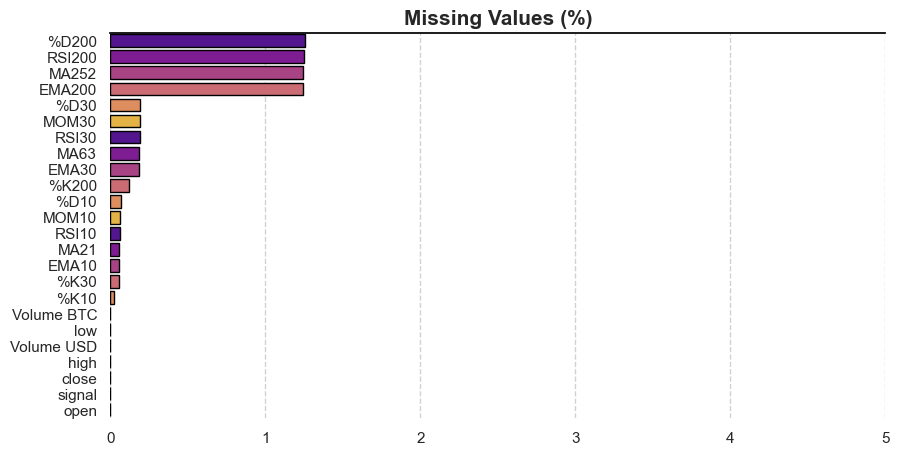

In [42]:
bar_plot(x = NaN_values,y = NaN_values.index,palette_len = NaN_values.index, 
         xlim = (0,1),xticklabels = range(0,10),yticklabels = NaN_values.index,
         figsize = (10,5), axis_grid = 'x')

In [43]:
train_df2 = train_df2.dropna() 
test_df2 = test_df2.dropna()

In [44]:
models = []
# Lightweight Models 
models.append(('LDA', LinearDiscriminantAnalysis()))  # Unsupervised Model 
models.append(('KNN', KNeighborsClassifier()))  # Unsupervised Model
models.append(('TREE', DecisionTreeClassifier())) # Supervised Model
models.append(('NB', GaussianNB())) # Unsupervised Model

# More Advanced Models
models.append(('GBM', GradientBoostingClassifier(n_estimators=25)))
models.append(('XGB',XGBClassifier(n_estimators=25,eval_metric='logloss')))
models.append(('CAT',CatBoostClassifier(silent=True,
                                        n_estimators=25)))
models.append(('RF', RandomForestClassifier(n_estimators=25)))

In [45]:
models[0]

('LDA', LinearDiscriminantAnalysis())

In [46]:
#eval_id[0]: Кросс-Валидация. Получить более надежную и обобщенную оценку производительности модели, проверяя ее на разных частях данных.
#eval_id[1]: Проверить, как хорошо модель обучается на предоставленных данных и насколько она переобучена (overfitting).
# Учимся и предсказываем на тестовых данных
#eval_id[2]: Обучаемся на тестовых данных проверяем на валидационных данных.
#eval_id[3]: Обучаемся и проверяем на всез данных

In [47]:
def modelEval(ldf,feature='signal',test_value=None,eval_id=[True,True,True,True],
              n_fold=5,scoring='accuracy',plot_id=[True,True]):
    
    print('Evaluation Function')
    print(f'Cross Validation Activated, n_splits : {n_fold}, scoring metric: {scoring}')
    
    ''' 1. Split Train/Evaluation <DataFrame> Set Split '''
        
    tr_df,eval_df = train_test_split(ldf,test_size=test_value,shuffle=False)

        
    ''' 2. Train/Test Feature Matrices + Target Variables Split'''
    
    y_train = tr_df[feature]
    X_train = tr_df.loc[:, tr_df.columns != feature]
    y_eval = eval_df[feature]
    X_eval = eval_df.loc[:, eval_df.columns != feature]
    X_one = pd.concat([X_train,X_eval],axis=0)
    y_one = pd.concat([y_train,y_eval],axis=0)
    
    print('');print(f'Using Features: {X_train.columns}')
    print(f'Target Variable: {feature}');print('')
        
    ''' 3. Visualise Training/Test Data'''
    if(plot_id[0]):
        
        # plot the training data
        fig = go.Figure()
        fig.add_trace(go.Scatter(x=tr_df.index, y=tr_df['signal'],mode='lines',name='Training Data', line={'width': 0.25}))
        fig.update_layout(height=300,width=800,template='plotly_white',title='Training Signal Visualisation',
                          margin=dict(l=50,r=80,t=50,b=40))
        
        # Plot the test data as well 
        if(eval_id[2]):
            fig.add_trace(go.Scatter(x=eval_df.index, y=eval_df['signal'],mode='lines',name='Test Data',line={'width': 0.25}))
            fig.update_layout(title='Training/Test Signal Visualisation')
        fig.show()
    
    ''' 4. Cross Validation, Training/Evaluation, one evaluation'''
    lst_res = []; names = []; lst_train = []; lst_eval = []; lst_one = []; lst_res_mean = []
    if(any(eval_id)):
        for name, model in models:  # cycle through models & evaluate either cv or train/test
            names.append(name)
            
            # Cross Validation Model on Training Se
            if(eval_id[0]):
                t0=time.time()
                kfold = KFold(n_splits=n_fold)
                cv_res = cross_val_score(model,X_train,y_train, cv=kfold, scoring=scoring)
                t1 = time.time()
                lst_res.append(cv_res)
                tt1 = t1-t0 # total time for n_fold cross evaluation
                
            # Evaluate Fit Model on Training Data
            t2 = time.time()
            if(eval_id[1]):
                t2 = time.time()
                res = model.fit(X_train,y_train)
                train_res = accuracy_score(res.predict(X_train),y_train); lst_train.append(train_res)
            if(eval_id[2]):
                if(eval_id[1] is False):  # If training hasn't been called yet
                    res = model.fit(X_train,y_train)
                eval_res = accuracy_score(res.predict(X_eval),y_eval); lst_eval.append(eval_res)
            t3 = time.time()
            tt2 = t3-t2 # total time for training/evaluation train/prediction
            
            # Evaluate model on entire dataset
            if(eval_id[3]):
                t4 = time.time()
                res = model.fit(X_one,y_one)
                one_res = accuracy_score(res.predict(X_one),y_one); lst_one.append(one_res)
                t5 = time.time()
                tt3 = t5-t4 # total time for training & evaluation on whole dataframe
            
            ''' [out] Verbal Outputs '''
            # Cross Validation / Training / Evaluation Model Evaluation / Section Times
            lst_res_mean.append(cv_res.mean())
            fn1 = cv_res.mean(); fn2 = cv_res.std();
            fn3 = train_res; fn4 = eval_res; fn5 = one_res
            print(f"{name} : {fn1:.3f}({fn2:.3f}) -> {tt1:.2f}s | {fn3:.3f} & {fn4:.3f} -> {tt2:.2f}s | {fn5:.3f} -> {tt3:.2}s")
      
    s0 = pd.Series(np.array(lst_res_mean),index=names)
    s1 = pd.Series(np.array(lst_train),index=names)
    s2 = pd.Series(np.array(lst_eval),index=names)
    s3 = pd.Series(np.array(lst_one),index=names)
    pdf = pd.concat([s0,s1,s2,s3],axis=1)
    pdf.columns = ['cv_average','train','test','all']
        
    ''' 5. Visual Ouputs '''
    if(plot_id[1]): 
        
        sns.set(style="whitegrid")
        fig,ax = plt.subplots(1,2,figsize=(15,4))
        ax[0].set_title(f'{n_fold} Cross Validation Results')
        sns.boxplot(data=lst_res, ax=ax[0], orient="v",width=0.3)
        ax[0].set_xticklabels(names)
        sns.stripplot(data=lst_res,ax=ax[0], orient='v',color=".3")
    
        sns.heatmap(pdf,ax=ax[1],annot=True,fmt='.3f',cmap='Blues')
        ax[1].set_title('Accuracy Scores')
        plt.show()

Evaluation Function
Cross Validation Activated, n_splits : 5, scoring metric: accuracy

Using Features: Index(['open', 'high', 'low', 'close', 'Volume BTC', 'Volume USD'], dtype='object')
Target Variable: signal



LDA : 0.528(0.011) -> 0.26s | 0.534 & 0.536 -> 0.07s | 0.536 -> 0.077s
KNN : 0.505(0.009) -> 1.79s | 0.703 & 0.525 -> 1.80s | 0.701 -> 1.8s
TREE : 0.507(0.010) -> 7.77s | 1.000 & 0.525 -> 1.99s | 1.000 -> 2.8s
NB : 0.512(0.019) -> 0.09s | 0.516 & 0.528 -> 0.03s | 0.519 -> 0.036s
GBM : 0.509(0.016) -> 32.20s | 0.552 & 0.528 -> 7.99s | 0.550 -> 1e+01s
XGB : 0.499(0.012) -> 1.54s | 0.613 & 0.522 -> 0.08s | 0.607 -> 0.088s
CAT : 0.498(0.011) -> 0.98s | 0.579 & 0.518 -> 0.20s | 0.573 -> 0.22s
RF : 0.502(0.010) -> 50.17s | 0.998 & 0.525 -> 13.34s | 0.997 -> 1.8e+01s


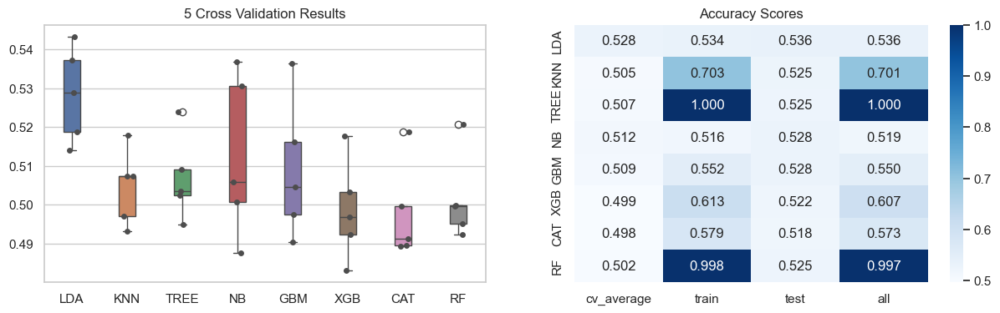

In [123]:
# Проверим модель без Feature Engineering
modelEval(train_df1,test_value=0.2)
# Вывод: 1) CV - CV.STD - TIME 2) модель обучена на обучающей и проверена на тестовых - accuracy train & test - time
# 3) acurracy - time(модель обучена на всех данных, предсказывает на тех же всех данных)

Evaluation Function
Cross Validation Activated, n_splits : 5, scoring metric: accuracy

Using Features: Index(['open', 'high', 'low', 'close', 'Volume BTC', 'Volume USD', 'MA21',
       'MA63', 'MA252', 'EMA10', 'EMA30', 'EMA200', 'MOM10', 'MOM30', 'RSI10',
       'RSI30', 'RSI200', '%K10', '%K30', '%K200', '%D10', '%D30', '%D200'],
      dtype='object')
Target Variable: signal



LDA : 0.914(0.007) -> 0.88s | 0.916 & 0.917 -> 0.23s | 0.916 -> 0.27s
KNN : 0.583(0.023) -> 4.44s | 0.816 & 0.565 -> 6.04s | 0.820 -> 7.3s
TREE : 0.862(0.035) -> 14.50s | 1.000 & 0.836 -> 3.74s | 1.000 -> 4.9s
NB : 0.782(0.009) -> 0.22s | 0.786 & 0.778 -> 0.07s | 0.783 -> 0.11s
GBM : 0.908(0.005) -> 114.15s | 0.912 & 0.902 -> 28.70s | 0.909 -> 3.6e+01s
XGB : 0.923(0.004) -> 2.00s | 0.942 & 0.920 -> 0.18s | 0.941 -> 0.19s
CAT : 0.919(0.003) -> 1.99s | 0.929 & 0.911 -> 0.42s | 0.927 -> 0.45s
RF : 0.908(0.007) -> 51.37s | 1.000 & 0.833 -> 13.83s | 1.000 -> 1.8e+01s


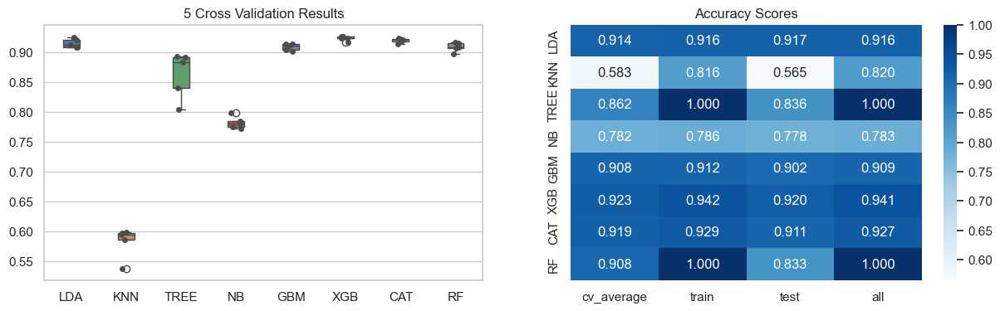

In [48]:
# Проверим модель с Feature Engineering
modelEval(train_df2,test_value=0.2)

In [50]:
# Мы сделали feature engeneering и удалили некоторые признаки; попробуем определить наиболее важные признаки и
# остальные отбросим

#1)Уменьшение размерности за счет важности функций

    
# Linear Correlation w/ abs() function.
# SHAP Values of Catboost Regression Model (n_est)
# RandomForest Regressor (n_est)
# XGBoost Regressor (n_est)
# CatBoost Regressor (n_est)
# SelectKBest (k)

# The indivual scores are combined and scaled using MinMaxScaler() & Plot.
# The y-axis represents the total score (higher score is better, max -> Number of approaches).
# he x-axis represents the corresponding features of input dataframe.


In [49]:
from sklearn.feature_selection import SelectKBest,f_regression
from xgboost import plot_importance,XGBRegressor
from catboost import CatBoostClassifier,CatBoostRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import preprocessing
import shap
import seaborn as sns

cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Plot Correlation to Target Variable only
def corrMat(df,target='signal',figsize=(9,0.5),ret_id=False):
    
    corr_mat = df.corr().round(2)
    shape = corr_mat.shape[0]
    corr_mat = corr_mat.transpose()
    corr = corr_mat.loc[:, df.columns == target].transpose().copy()
    
    if(ret_id):
        return corr

''' Feature Importance '''
# Various Approaches for quick FI evaluation

def fi(ldf,target='signal',n_est=25,num_only=True,
       drop_id=None,target_cat=True,drop_na=False):
    
    # Select only numerical features
    if(num_only):
        ldf = ldf.select_dtypes(include=['float64','int64'])    
    
    # Drop all NaN
    if(drop_na):
        print(f'Before NaN drop: {ldf.shape}')
        ldf = ldf.dropna()
        print(f'After NaN dropped: {ldf.shape}')
    
    
    ldf = ldf.copy()
    # If target is categorical string variable
    if(target_cat):
        cats = ldf[target].unique()
        cats_id = [i for i in range(0,len(cats))]
        maps = dict(zip(cats,cats_id))    
        ldf[target] = ldf[target].map(maps)
    
    # If any features are desired to be droped 
    if(drop_id is not None):
        ldf = ldf.drop(drop_id,axis=1)

    # Input dataframe containing feature & target variable
    y = ldf[target]
    X = ldf.drop(target,axis=1)
    
#   CORRELATION
    imp = corrMat(ldf,target,figsize=(15,0.5),ret_id=True)
    del imp[target]
    s1 = imp.squeeze(axis=0);s1 = abs(s1)
    s1.name = 'CORR'

    
#   SHAP
    model = CatBoostRegressor(silent=True,n_estimators=n_est).fit(X,y)
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X)
    shap_sum = np.abs(shap_values).mean(axis=0)
    s2 = pd.Series(shap_sum,index=X.columns,name='CAT_SHAP').T

    
#   CATBOOST
    model = CatBoostRegressor(silent=True,n_estimators=n_est).fit(X,y)
    fit = model.fit(X,y)
    rf_fi = pd.DataFrame(model.feature_importances_,index=X.columns,
                                         columns=['CAT'])
    rf_fi.sort_values('CAT',ascending=False)
    s3 = rf_fi.T.squeeze(axis=0)

    
#   RANDOMFOREST
    model = RandomForestRegressor(n_est,random_state=0, n_jobs=-1)
    fit = model.fit(X,y)
    rf_fi = pd.DataFrame(model.feature_importances_,index=X.columns,
                                         columns=['RF'])
    rf_fi.sort_values('RF',ascending=False)
    s4 = rf_fi.T.squeeze(axis=0)


#   XGB 
    model=XGBRegressor(n_estimators=n_est,learning_rate=0.5,verbosity = 0)
    model.fit(X,y)
    data = model.feature_importances_
    s5 = pd.Series(data,index=X.columns,name='XGB').T


# KBEST
    model = SelectKBest(k=5, score_func=f_regression)
    fit = model.fit(X,y)
    data = fit.scores_
    s6 = pd.Series(data,index=X.columns,name='KBEST')

    # Combine Scores
    df0 = pd.concat([s1,s2,s3,s4,s5,s6],axis=1)
    df0.rename(columns={'target':'lin corr'})

    # MinMax Scaler
    x = df0.values 
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    df = pd.DataFrame(x_scaled,index=df0.index,columns=df0.columns)
    df = df.rename_axis(f'<b>FI APPROACH</b>', axis=1)
    df = df.rename_axis('Feature', axis=0)
    
    pd.options.plotting.backend = "plotly"
    fig = df.plot(kind='bar',title='<b>SCALED FEATURE IMPORTANCE</b>',
                  color_discrete_sequence=px.colors.qualitative.T10)
    fig.update_layout(template='plotly_white',height=400,
                     font=dict(family='sans-serif',size=12),
                     margin=dict(l=60, r=40, t=50, b=10))
    fig.update_traces(width=0.25)
    fig.show()

In [53]:
train_df2

,open,high,low,close,Volume BTC,Volume USD,signal,MA21,MA63,MA252,...,MOM30,RSI10,RSI30,RSI200,%K10,%K30,%K200,%D10,%D30,%D200
unix,,,,,,,,,,,,,,,,,,,,,
2021-07-06 16:42:00+00:00,34145.24,34145.66,34145.02,34145.02,0.493892,16863.951193,0.0,34166.572,34275.940333,34096.15925,...,-331.10,38.373142,43.446517,51.074783,47.395210,36.307339,24.326713,31.792517,13.676317,51.884311
2021-07-06 16:43:00+00:00,34113.94,34148.82,34113.94,34137.80,1.448020,49432.217156,0.0,34157.972,34264.983333,34096.88575,...,-328.71,37.481881,43.111102,51.015859,43.210352,37.861915,21.698770,31.355008,13.505199,49.886822
2021-07-06 16:44:00+00:00,34126.02,34132.20,34104.02,34126.16,0.420358,14345.221087,0.0,34157.588,34254.732000,34097.64915,...,-307.54,35.984719,42.563079,50.920673,34.244782,33.278443,17.196565,35.815899,14.871504,50.301951
2021-07-06 16:45:00+00:00,34115.74,34151.52,34115.74,34149.48,0.967030,33023.565156,0.0,34153.631,34247.436000,34098.44755,...,-218.88,41.211927,44.037447,51.104364,71.475272,50.733533,26.274373,40.624630,16.153651,50.492432
2021-07-06 16:46:00+00:00,34141.12,34180.32,34130.45,34170.98,1.684914,57575.174897,0.0,34155.327,34240.111667,34099.52190,...,-219.73,45.749824,45.374785,51.273348,87.758847,66.826347,34.608675,50.279441,20.207451,51.909509
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-31 02:36:00+00:00,47160.65,47196.27,47134.00,47140.96,0.246236,11607.811798,0.0,47276.522,47352.532667,48136.16725,...,-273.01,30.485770,34.623768,41.966119,7.093146,4.758525,3.431373,13.883055,8.563971,1.933530
2021-08-31 02:37:00+00:00,47135.70,47141.85,47100.00,47135.02,1.932630,91094.550874,0.0,47252.144,47344.585333,48128.59590,...,-238.42,30.069040,34.452853,41.923952,16.850310,11.833080,10.186451,5.530535,4.065777,0.981767
2021-08-31 02:38:00+00:00,47120.00,47389.40,47085.00,47268.57,18.450655,872136.075050,0.0,47243.352,47340.372000,48121.49770,...,-126.40,47.870516,41.203400,43.213262,60.305519,59.035215,51.163633,25.208940,18.828141,4.703357


In [50]:
fi(train_df2)

In [55]:
train_df2_FI = train_df2.drop(columns=['open','high','low','close','Volume USD','Volume BTC','MA63','EMA10','%K10'])

In [56]:
train_df2_FI

,signal,MA21,MA252,EMA30,EMA200,MOM10,MOM30,RSI10,RSI30,RSI200,%K30,%K200,%D10,%D30,%D200
unix,,,,,,,,,,,,,,,
2021-07-06 16:42:00+00:00,0.0,34166.572,34096.15925,34248.508167,34182.700189,-93.69,-331.10,38.373142,43.446517,51.074783,36.307339,24.326713,31.792517,13.676317,51.884311
2021-07-06 16:43:00+00:00,0.0,34157.972,34096.88575,34241.365695,34182.185874,-86.00,-328.71,37.481881,43.111102,51.015859,37.861915,21.698770,31.355008,13.505199,49.886822
2021-07-06 16:44:00+00:00,0.0,34157.588,34097.64915,34233.933061,34181.545083,-3.84,-307.54,35.984719,42.563079,50.920673,33.278443,17.196565,35.815899,14.871504,50.301951
2021-07-06 16:45:00+00:00,0.0,34153.631,34098.44755,34228.484470,34181.178886,-39.57,-218.88,41.211927,44.037447,51.104364,50.733533,26.274373,40.624630,16.153651,50.492432
2021-07-06 16:46:00+00:00,0.0,34155.327,34099.52190,34224.774500,34181.062581,16.96,-219.73,45.749824,45.374785,51.273348,66.826347,34.608675,50.279441,20.207451,51.909509
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-31 02:36:00+00:00,0.0,47276.522,48136.16725,47363.558055,47947.757165,-176.36,-273.01,30.485770,34.623768,41.966119,4.758525,3.431373,13.883055,8.563971,1.933530
2021-08-31 02:37:00+00:00,0.0,47252.144,48128.59590,47348.813665,47939.670228,-243.78,-238.42,30.069040,34.452853,41.923952,11.833080,10.186451,5.530535,4.065777,0.981767
2021-08-31 02:38:00+00:00,0.0,47243.352,48121.49770,47343.636654,47932.992613,-87.92,-126.40,47.870516,41.203400,43.213262,59.035215,51.163633,25.208940,18.828141,4.703357


Evaluation Function
Cross Validation Activated, n_splits : 5, scoring metric: accuracy

Using Features: Index(['MA21', 'MA252', 'EMA30', 'EMA200', 'MOM10', 'MOM30', 'RSI10', 'RSI30',
       'RSI200', '%K30', '%K200', '%D10', '%D30', '%D200'],
      dtype='object')
Target Variable: signal



LDA : 0.907(0.005) -> 0.56s | 0.908 & 0.910 -> 0.14s | 0.909 -> 0.17s
KNN : 0.718(0.022) -> 2.75s | 0.968 & 0.598 -> 2.56s | 0.968 -> 2.6s
TREE : 0.858(0.040) -> 8.89s | 1.000 & 0.842 -> 2.26s | 1.000 -> 3.0s
NB : 0.794(0.007) -> 0.17s | 0.794 & 0.785 -> 0.06s | 0.792 -> 0.07s
GBM : 0.909(0.005) -> 67.72s | 0.911 & 0.902 -> 17.41s | 0.909 -> 2.2e+01s
XGB : 0.923(0.005) -> 0.66s | 0.942 & 0.920 -> 0.16s | 0.940 -> 0.16s
CAT : 0.920(0.004) -> 1.03s | 0.926 & 0.915 -> 0.33s | 0.925 -> 0.31s
RF : 0.911(0.009) -> 38.15s | 1.000 & 0.894 -> 9.79s | 1.000 -> 1.3e+01s


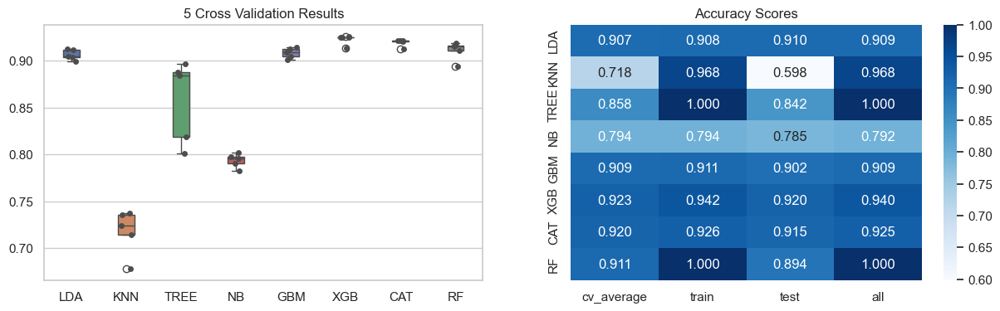

In [57]:
modelEval(train_df2_FI,test_value=0.2)